In [18]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

# Settings
%matplotlib inline
pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", None)

In [182]:
# Load data
df = pd.read_csv("kc_house_data.csv", index_col = "id")  # KC data
df_zipcodes = pd.read_excel("kc_zipcodes.xlsx")  # Zipcode data
df = df.join(df_zipcodes.set_index("zipcode"), on="zipcode")  #  Join

# Load map 
kc_map = plt.imread("kc_map01.png")
BBox = (df.long.min(), df.long.max(), df.lat.min(), df.lat.max())

In [184]:
# Correlation matrix as a pandas table
exclude = ["bedrooms", "floors", "condition", "yr_built", "zipcode_pop_natl_rank", "city_population", "zipcode_population", "sqft_living15"]
df.drop(exclude, axis=1).corr().style.background_gradient(cmap="RdBu", vmin=-1, vmax=1).set_precision(2)  # vmin = min value, vmax = max value

,price,bathrooms,sqft_living,sqft_lot,waterfront,view,grade,sqft_above,sqft_basement,yr_renovated,zipcode,lat,long,sqft_lot15,zipcode_pop_density
price,1.00,0.53,0.70,0.09,0.27,0.40,0.67,0.61,0.32,0.13,-0.05,0.31,0.02,0.08,0.10
bathrooms,0.53,1.00,0.75,0.09,0.06,0.19,0.66,0.69,0.28,0.05,-0.20,0.02,0.22,0.09,-0.17
sqft_living,0.70,0.75,1.00,0.17,0.10,0.28,0.76,0.88,0.44,0.06,-0.20,0.05,0.24,0.18,-0.21
sqft_lot,0.09,0.09,0.17,1.00,0.02,0.07,0.11,0.18,0.02,0.01,-0.13,-0.09,0.23,0.72,-0.23
waterfront,0.27,0.06,0.10,0.02,1.00,0.40,0.08,0.07,0.08,0.09,0.03,-0.01,-0.04,0.03,-0.01
view,0.40,0.19,0.28,0.07,0.40,1.00,0.25,0.17,0.28,0.10,0.08,0.01,-0.08,0.07,0.05
grade,0.67,0.66,0.76,0.11,0.08,0.25,1.00,0.76,0.17,0.01,-0.18,0.11,0.20,0.12,-0.14
sqft_above,0.61,0.69,0.88,0.18,0.07,0.17,0.76,1.00,-0.05,0.02,-0.26,-0.00,0.34,0.19,-0.31
sqft_basement,0.32,0.28,0.44,0.02,0.08,0.28,0.17,-0.05,1.00,0.07,0.07,0.11,-0.14,0.02,0.14
yr_renovated,0.13,0.05,0.06,0.01,0.09,0.10,0.01,0.02,0.07,1.00,0.06,0.03,-0.07,0.01,0.08


In [69]:
def draw_scatter(color_cat, point_size, colors, sizes, point_alpha, marker="o", legend=False, segments=0, edgecolor="black"):
    
    # Create segments with quartile cut
    if segments > 0:
        labels = range(segments)
        df["segment"] = pd.qcut(color_cat, segments, labels=labels)
    else:  # 0 = don't cut (keep original range)
        df["segment"] = color_cat
    
    # Figure
    fig, ax = plt.subplots(figsize = (25, 25))
    ax.set_title(f"Spatial {color_cat.name} data on King County map", fontsize=24)
    
    # Map
    ax.set_xlim(BBox[0], BBox[1])  # Longitude boundaries
    ax.set_ylim(BBox[2], BBox[3])  # Latitude bondaries
    ax.imshow(kc_map, zorder=0, extent=BBox, aspect="equal")
    
    # Plot 
    sns.scatterplot(x=df.long, y=df.lat, hue=df["segment"], palette=colors, size=point_size, alpha=point_alpha, marker=marker, sizes=sizes, legend=legend, edgecolor=edgecolor);

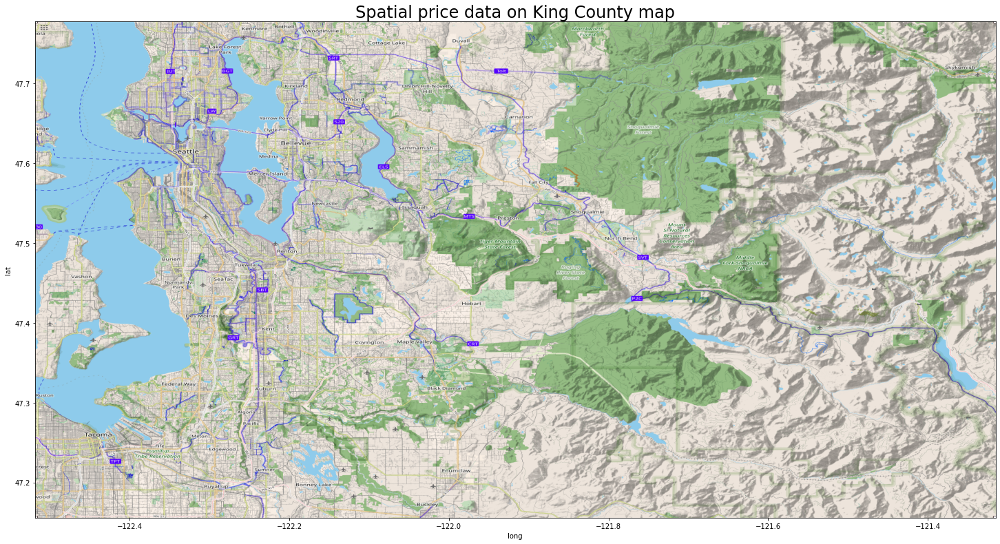

In [5]:
draw_scatter(color_cat=df["price"], point_size=df["sqft_living"], colors="coolwarm", sizes=(0, 0), point_alpha=1, marker="s", legend=False, segments=0)

---
# 1. Price and grade 
- Red areas with large squares $ \longrightarrow $ expensive areas with high grade houses

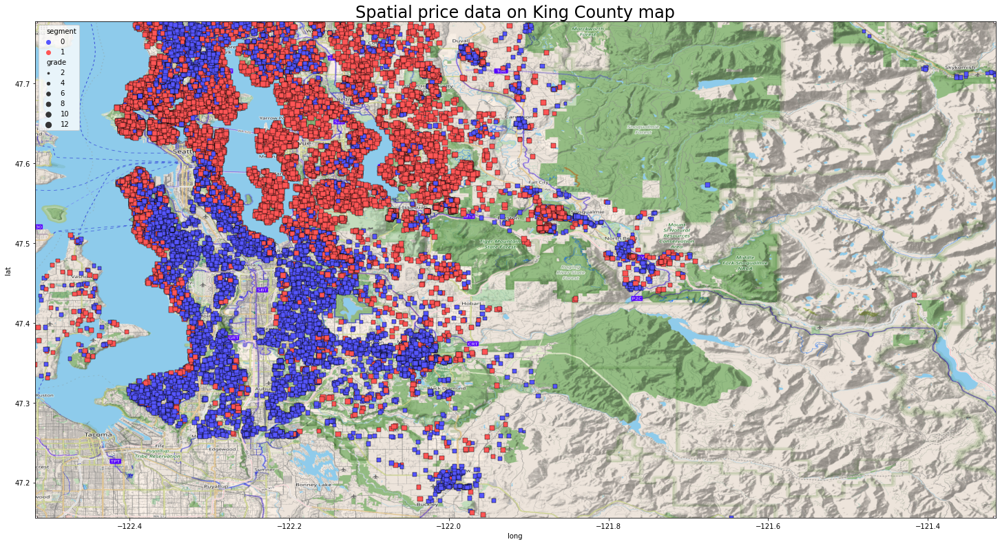

In [188]:
draw_scatter(color_cat=df["price"], point_size=df["grade"], colors="seismic", sizes=(1, 75), point_alpha=1, marker="s", legend="brief", segments=2)

---
# 2. Price per sqft and sqft living
- Red areas with large squares $ \longrightarrow $ = expensive areas with large houses 

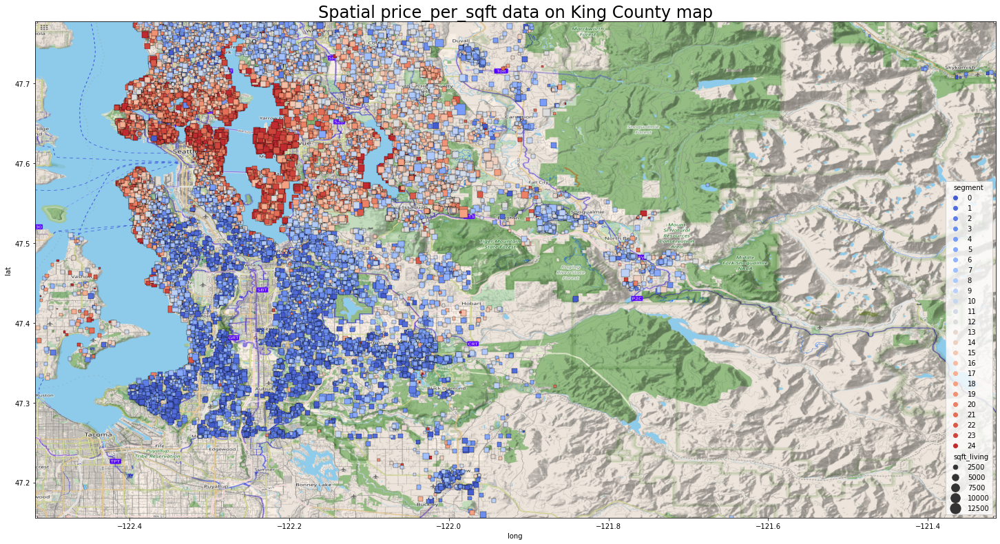

In [7]:
df["price_per_sqft"] = df["price"] / df["sqft_living"]
draw_scatter(color_cat=df["price_per_sqft"], point_size=df["sqft_living"], colors="coolwarm", sizes=(1, 250), point_alpha=1, marker="s", legend="brief", segments=25)

---
# 3. Price error rates/sizes
- Red areas with large circles $ \longrightarrow $ more errors and/or larger errors

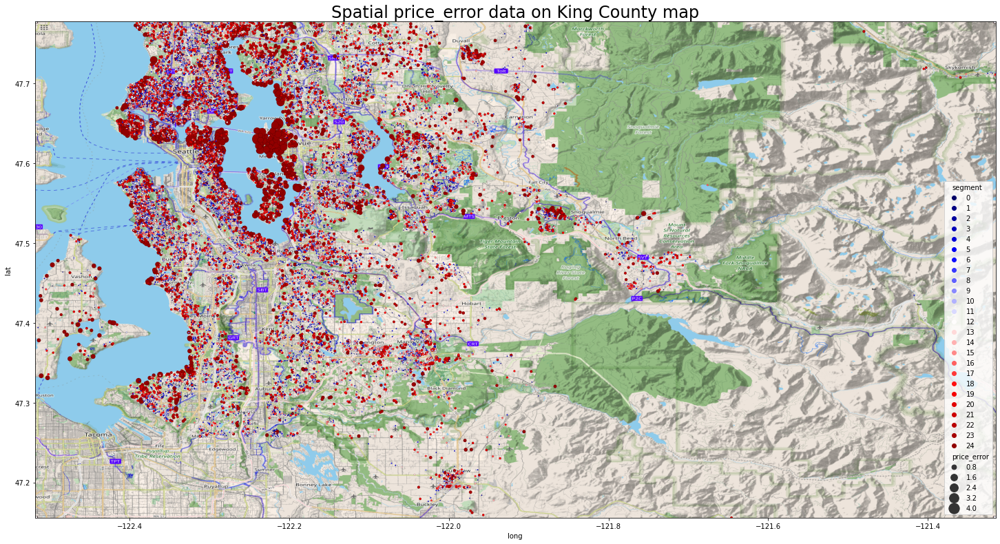

In [189]:
target = "price"
exclude = ["date", "city"]
X = [i for i in df.columns if i != target and i not in exclude]
y = target

reg = LinearRegression()
model = reg.fit(df[X], df[y])
#df["price_error"] = abs(df["price"] - model.predict(df[X]))

draw_scatter(color_cat=df["price_error"], point_size=df["price_error"], colors="seismic", sizes=(1, 250), point_alpha=1, legend="brief", marker="o", segments=25)

---
# 4. Zipcode density/sparsity
- Small red circles $ \longrightarrow $ highly populated areas
- Large blue circles $ \longrightarrow $ sparsly populated areas 

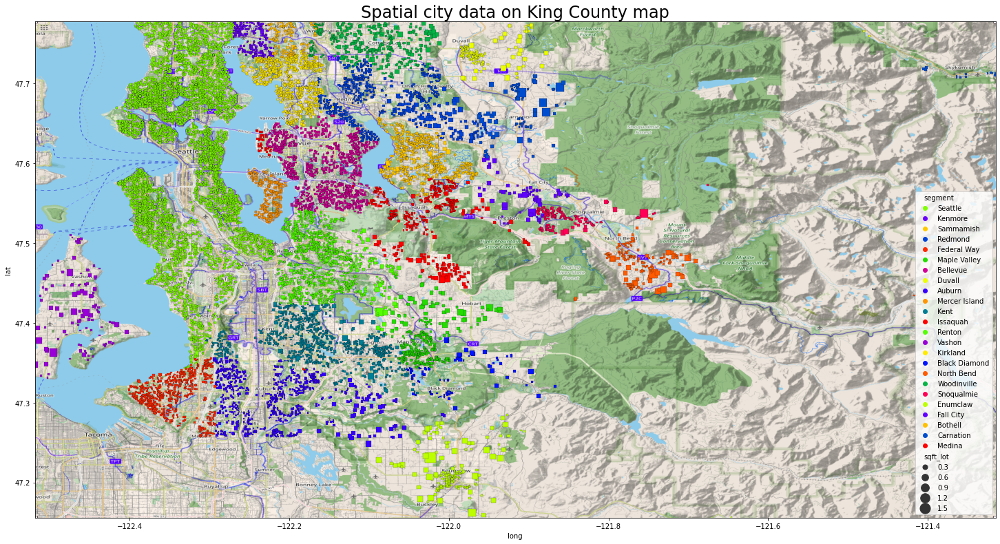

In [216]:
df["zipcode_pop_sparsity"] = df["zipcode_pop_density"].max() + df["zipcode_pop_density"].max() - df["zipcode_pop_density"]
draw_scatter(color_cat=df["city"], point_size=df["sqft_lot"], colors="prism", sizes=(5, 250), point_alpha=1, marker="s", legend="brief", segments=0)

---
# 5. The only map you actually need
- Blue circles $ \longrightarrow $ affordable waterfront houses

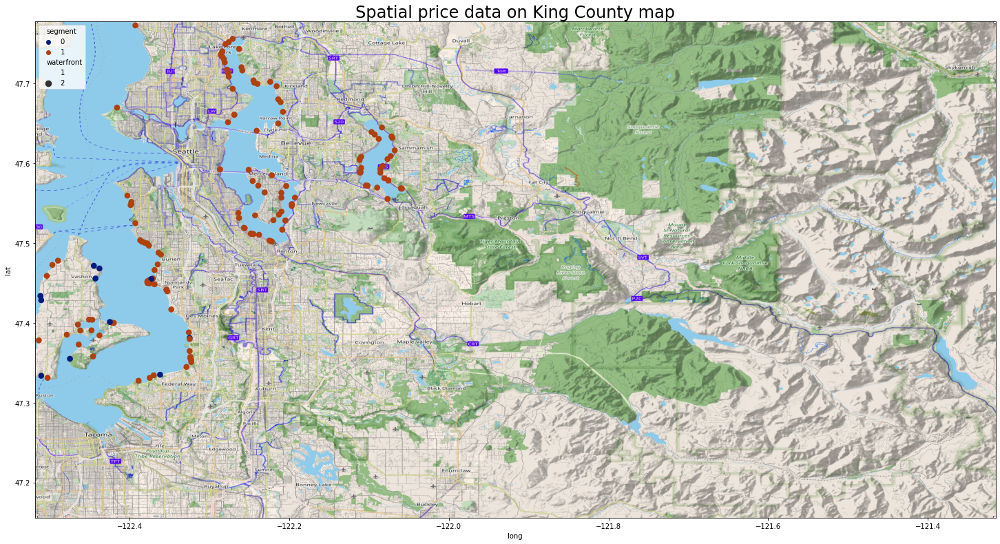

In [193]:
draw_scatter(color_cat=df["price"], point_size=df["waterfront"]+1, colors="dark", sizes=(0, 75), point_alpha=1, marker="o", legend="brief", segments=2)

---
# 6. All houses with a view
- Orange $ \longrightarrow $ waterfront

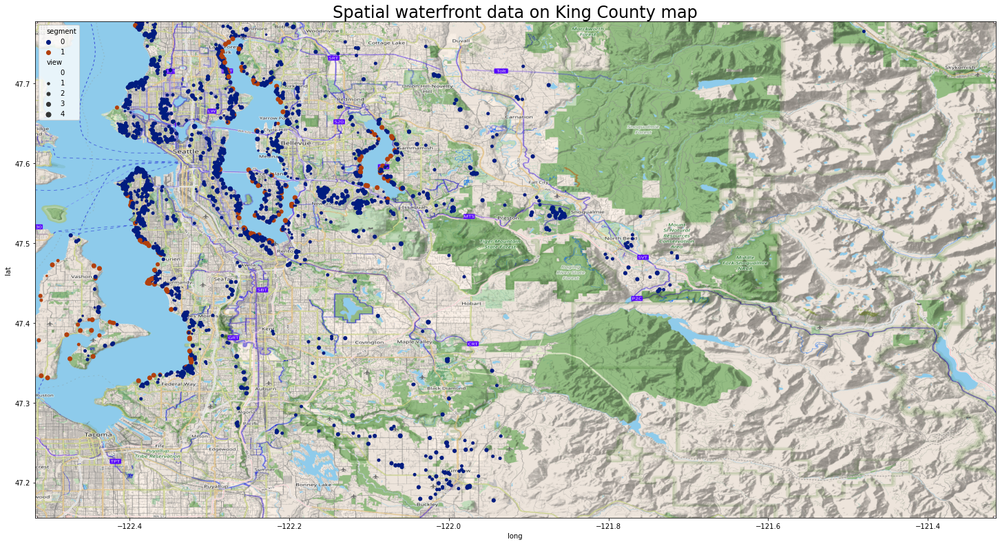

In [10]:
draw_scatter(color_cat=df["waterfront"], point_size=df["view"], colors="dark", sizes=(0, 50), point_alpha=1, marker="o", legend="brief", segments=0)

---
# 7. Houses with lots of bathrooms
- Large red squares $ \longrightarrow $ large houess with a lot of bathrooms

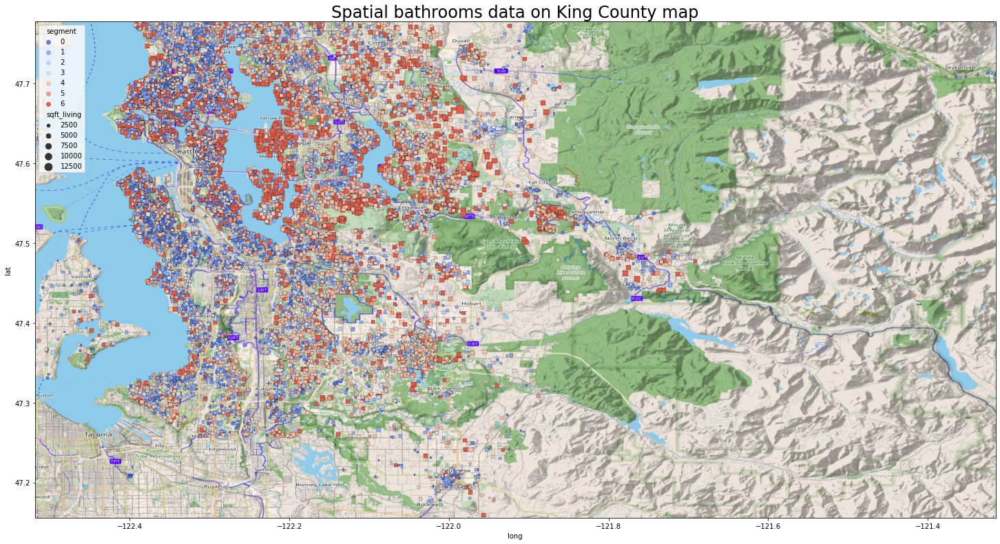

In [11]:
draw_scatter(color_cat=df["bathrooms"], point_size=df["sqft_living"], colors="coolwarm", sizes=(1, 125), point_alpha=1, marker="s", legend="brief", segments=7)

---
# 8. Recent sales
- Darker areas $ \longrightarrow $ more recent sales

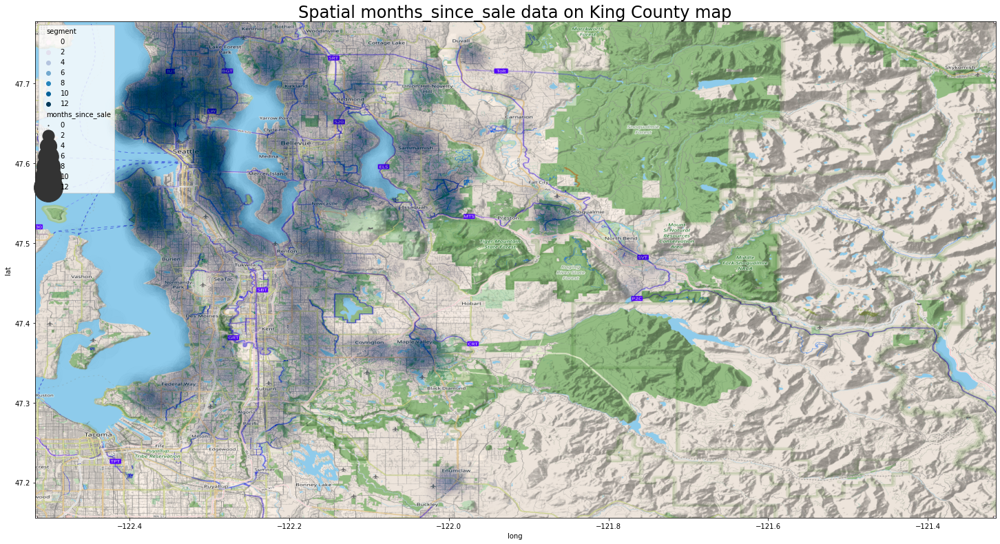

In [212]:
last_sale = df["date"].astype(str).str[0:6].max()  # Last sale in format yyyy:mm
df["months_since_sale"] = df["date"].apply(lambda date: (int(last_sale[0:4]) - int(date[0:4])) * 12 + int(last_sale[4:6]) - int(date[4:6]))  # Lambda function that converts date to months since last sale
draw_scatter(color_cat=df["months_since_sale"], point_size=df["months_since_sale"], colors="PuBu", sizes=(1, 1750), point_alpha=0.002, marker="o", legend="brief", segments=0)

---

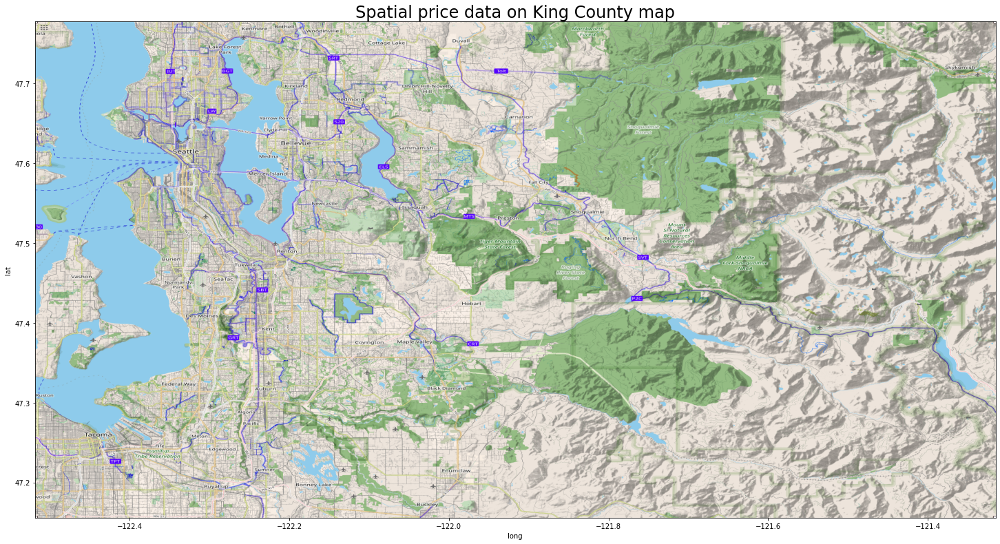

In [13]:
draw_scatter(color_cat=df["price"], point_size=df["sqft_living"], colors="coolwarm", sizes=(0, 0), point_alpha=1, marker="s", segments=0)

---

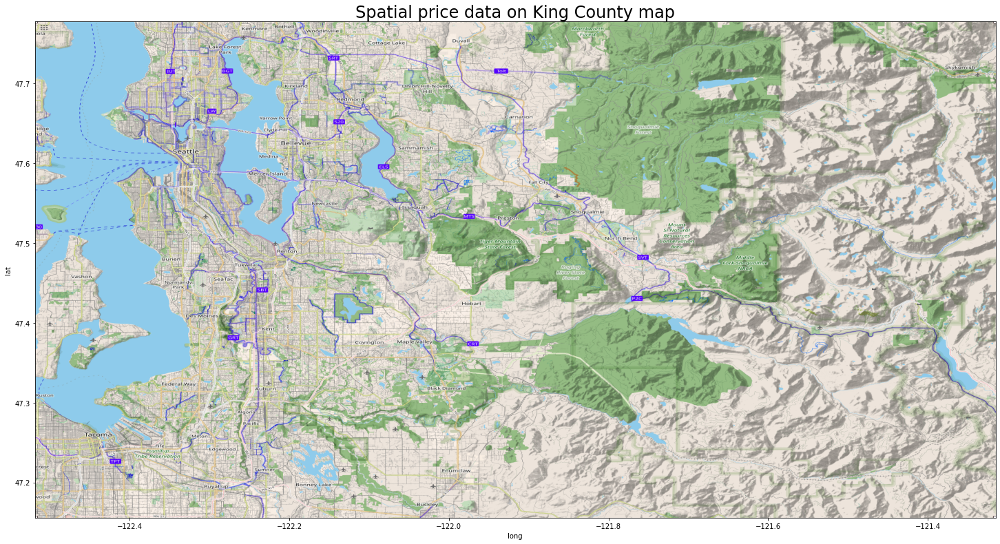

In [14]:
draw_scatter(color_cat=df["price"], point_size=df["sqft_living"], colors="coolwarm", sizes=(0, 0), point_alpha=1, marker="s", segments=0)

---

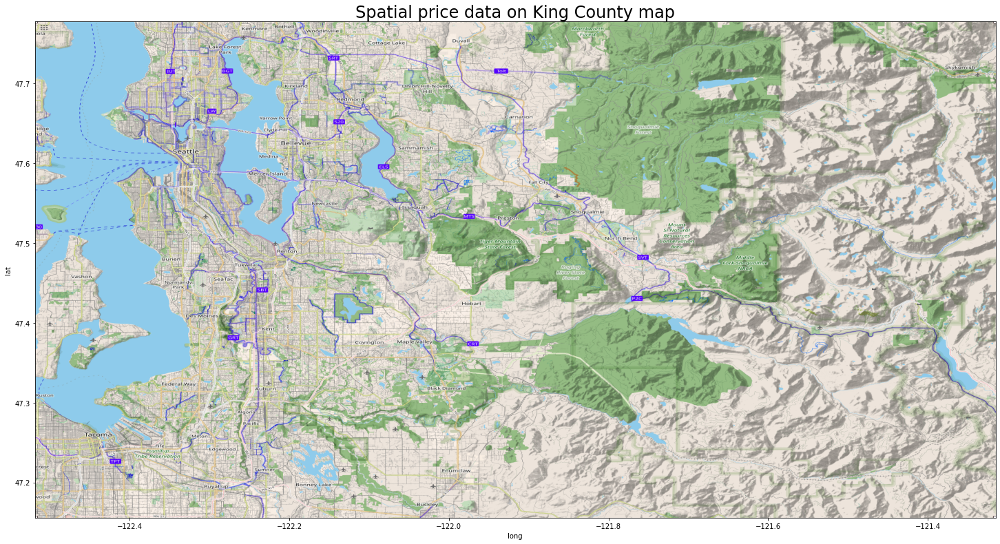

In [15]:
draw_scatter(color_cat=df["price"], point_size=df["sqft_living"], colors="coolwarm", sizes=(0, 0), point_alpha=1, marker="s", segments=0)